In [1]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
import numpy as np
from tqdm.notebook import tqdm#barrita


In [4]:
subhalo_df = pd.read_csv('subhalo_tables/subhalo402555.0_02R200_1R200.csv')

In [5]:
subhalo_df.head()

,Unnamed: 0,M,x,y,z,Vx,Vy,Vz,Metallicity,U,StellarFormationTime,Jx,Jy,Jz,Total Energy,Circularity
0,0,92693.429688,0.019062,-0.068940,0.043204,22.503883,23.792843,24.225203,1.850289,-618667.3750,0.276751,-2.698017,0.510481,2.004939,-617837.682709,0.173297
1,1,38259.960938,-0.034823,-0.075116,-0.012382,32.536095,-29.003364,-9.698210,2.757354,-618565.5000,0.510194,0.369367,-0.740587,3.453967,-617568.576048,0.298543
2,2,55052.875000,-0.018019,0.045213,-0.011066,41.037501,-34.556065,3.026793,1.373180,-618854.8125,0.318028,-0.245532,-0.399563,-1.232759,-617411.132709,-0.106553
3,3,48052.269531,0.070157,-0.001468,0.018448,-13.677818,-26.925413,45.911944,2.980625,-618088.6875,0.512458,0.429346,-3.473398,-1.909093,-616578.703936,-0.165012
4,4,38457.070312,0.023098,-0.191504,-0.012034,-24.693581,22.139616,7.474309,2.482507,-617062.8125,0.410023,-1.164940,0.124512,-4.217539,-616484.912091,-0.364542


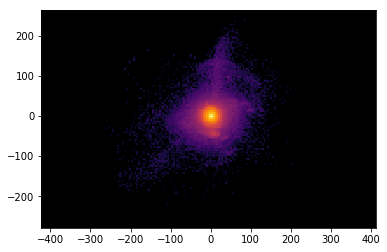

In [6]:
plt.hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm())
plt.axis('equal')
ax = plt.gca()
ax.set_facecolor('black')
plt.show()

In [2]:
subhalo_df = pd.read_csv('subhalo_tables/subhalo547844.0_counterrotating.csv')

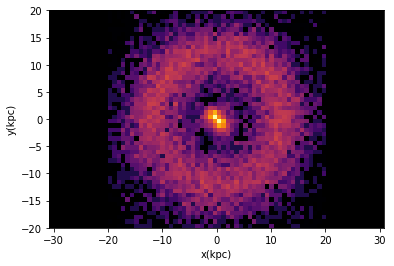

In [7]:
plt.hist2d(subhalo_df['x'],subhalo_df['y'],bins=50,cmap='inferno',norm=mpl.colors.LogNorm(),range=[[-20, 20], [-20, 20]])
plt.axis('equal')
ax = plt.gca()
ax.set_facecolor('black')
plt.xlabel('x(kpc)')
plt.ylabel('y(kpc)')
plt.savefig('test_visualization.png')

In [4]:
subhalo_df = pd.read_csv('subhalo_tables/subhalo455291.0.csv')

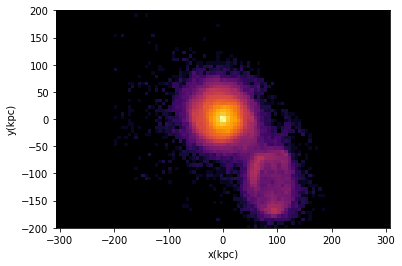

In [5]:
plt.hist2d(subhalo_df['x'],subhalo_df['y'],bins=64,cmap='inferno',norm=mpl.colors.LogNorm(),range=[[-200, 200], [-200, 200]])
plt.axis('equal')
ax = plt.gca()
ax.set_facecolor('black')
plt.xlabel('x(kpc)')
plt.ylabel('y(kpc)')
plt.savefig('test_visualization')

In [2]:
Classified_subhalos = np.genfromtxt('Classified_subhalos_TNG50-1.csv',skip_header=1,delimiter=',')

In [ ]:
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]

height = 5
length = 5
maximum = height * length


fig, axs = plt.subplots(height, length, figsize=[28.66,20.46], dpi=200)
circle = np.linspace(0, 2 * np.pi, 100)

inicio = 30
index = inicio
for i in tqdm(range(height)):
    for j in tqdm(range(length)):
        subhaloid = Subhalos_ids[index]
        R200 = Subhalos_R200[index]
        subhalo_df = pd.read_csv('subhalo_tables/subhalo%s.csv'%subhaloid)
        
        axs[i, j].set_xlabel('x(ckpc)')
        axs[i, j].set_ylabel('y(ckpc)')
        axs[i, j].set_title('Subhalo %s'%subhaloid, fontsize=10)
        axs[i, j].set(xlim=(-R200-1, R200+1), ylim=(-R200-1, R200+1))
        #circulo de R200
        axs[i, j].plot(R200 * np.cos(circle), R200 * np.sin(circle), zorder=20)
        axs[i, j].plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=20)
        #densidad de particulas estelares
        axs[i, j].hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-R200, R200], [-R200, R200]])
        axs[i, j].set_aspect('equal','box')
        axs[i, j].set_facecolor('black')
        
        index += 1


plt.tight_layout()
plt.savefig('subhalo_images/Subhalos_faceon_5x5_%s.png'%inicio)


In [ ]:
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]

height = 5
length = 5
maximum = height * length


fig, axs = plt.subplots(height, length, figsize=[28.66,20.46], dpi=200)
circle = np.linspace(0, 2 * np.pi, 100)



index = inicio
for i in tqdm(range(height)):
    for j in tqdm(range(length)):
        subhaloid = Subhalos_ids[index]
        R200 = Subhalos_R200[index]
        subhalo_df = pd.read_csv('subhalo_tables/subhalo%s.csv'%subhaloid)
        
        axs[i, j].set_xlabel('x(ckpc)')
        axs[i, j].set_ylabel('z(ckpc)')
        axs[i, j].set_title('Subhalo %s'%subhaloid, fontsize=10)
        axs[i, j].set(xlim=(-R200-1, R200+1), ylim=(-R200-1, R200+1))
        #circulo de R200
        axs[i, j].plot(R200 * np.cos(circle), R200 * np.sin(circle), zorder=20)
        axs[i, j].plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=20)
        #densidad de particulas estelares
        axs[i, j].hist2d(subhalo_df['x'],subhalo_df['z'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-R200, R200], [-R200, R200]])
        axs[i, j].set_aspect('equal','box')
        axs[i, j].set_facecolor('black')
        
        index += 1


plt.tight_layout()
plt.savefig('subhalo_images/Subhalos_edgeon_5x5_%s.png'%inicio)


In [ ]:
len(Subhalos_ids)

In [ ]:
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]

height = 5
length = 5
maximum = height * length


fig, axs = plt.subplots(height, length, figsize=[28.66,20.46], dpi=200)
circle = np.linspace(0, 2 * np.pi, 100)


index = inicio
for i in tqdm(range(height)):
    for j in tqdm(range(length)):
        subhaloid = Subhalos_ids[index]
        R200 = Subhalos_R200[index]
        subhalo_df = pd.read_csv('subhalo_tables/subhalo%s_counterrotating.csv'%subhaloid)
        
        axs[i, j].set_xlabel('x(ckpc)')
        axs[i, j].set_ylabel('y(ckpc)')
        axs[i, j].set_title('Subhalo %s (counterrotating)'%subhaloid, fontsize=10)
        axs[i, j].set(xlim=(-R200-1, R200+1), ylim=(-R200-1, R200+1))
        #circulo de R200
        axs[i, j].plot(R200 * np.cos(circle), R200 * np.sin(circle), zorder=20)
        axs[i, j].plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=20)
        #densidad de particulas estelares
        axs[i, j].hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-R200, R200], [-R200, R200]])
        axs[i, j].set_aspect('equal','box')
        axs[i, j].set_facecolor('black')
        
        index += 1


plt.tight_layout()
plt.savefig('subhalo_images/Subhalos_faceon_5x5_counterrotating_%s.png'%inicio)


In [ ]:
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]

height = 5
length = 5
maximum = height * length


fig, axs = plt.subplots(height, length, figsize=[28.66,20.46], dpi=200)
circle = np.linspace(0, 2 * np.pi, 100)


index = inicio
for i in tqdm(range(height)):
    for j in tqdm(range(length)):
        subhaloid = Subhalos_ids[index]
        R200 = Subhalos_R200[index]
        subhalo_df = pd.read_csv('subhalo_tables/subhalo%s_counterrotating.csv'%subhaloid)
        
        axs[i, j].set_xlabel('x(ckpc)')
        axs[i, j].set_ylabel('z(ckpc)')
        axs[i, j].set_title('Subhalo %s (counterrotating)'%subhaloid, fontsize=10)
        axs[i, j].set(xlim=(-R200-1, R200+1), ylim=(-R200-1, R200+1))
        #circulo de R200
        axs[i, j].plot(R200 * np.cos(circle), R200 * np.sin(circle), zorder=20, label='R200')
        axs[i, j].plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=20, label='0.2R200')
        #densidad de particulas estelares
        axs[i, j].hist2d(subhalo_df['x'],subhalo_df['z'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-R200, R200], [-R200, R200]])
        axs[i, j].set_aspect('equal', 'box')
        axs[i, j].set_facecolor('black')
        
        index += 1


plt.tight_layout()
plt.savefig('subhalo_images/Subhalos_edgeon_5x5_counterrotating_%s.png'%inicio)


In [3]:
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]

for start in range(0, 261,10):
    inicio = start
    height = 5
    length = 5
    
    

In [8]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

Subhalos_R200 = Classified_subhalos[:,3]

height = 5
length = 5
maximum = height * length



#fig, axs = plt.subplots(height, length, figsize=[28.66,20.46], dpi=200)
circle = np.linspace(0, 2 * np.pi, 100)

inicio = 30
index = inicio

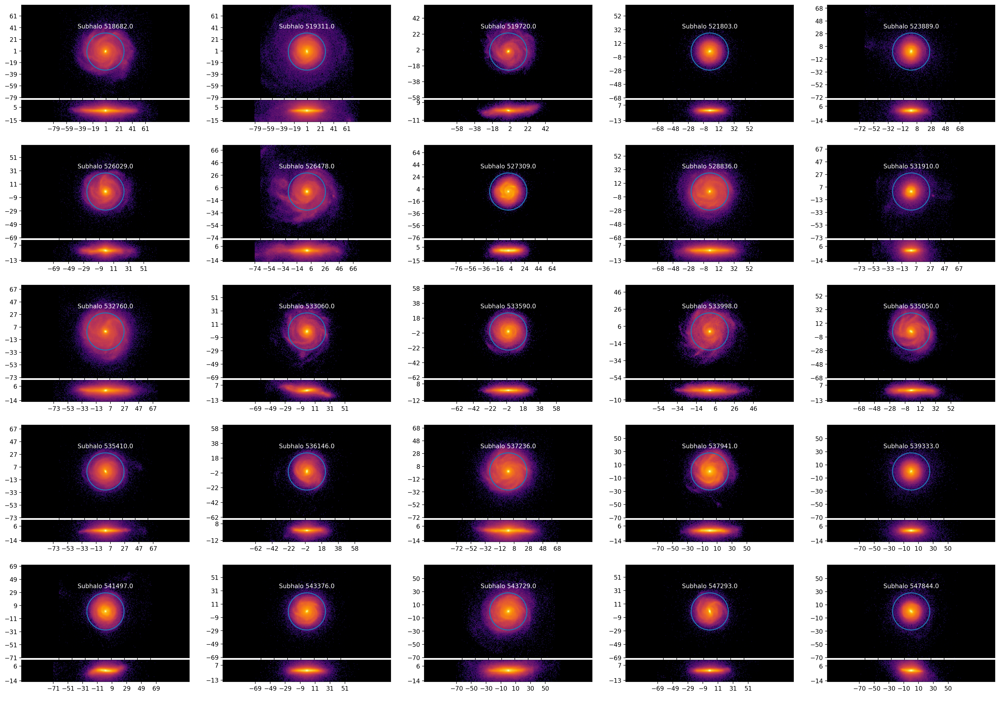

In [6]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

Classified_subhalos = np.genfromtxt('Classified_subhalos_TNG50-1.csv',skip_header=1,delimiter=',')
inicio = 30
step = 20
index = inicio
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]
circle = np.linspace(0, 2 * np.pi, 100)

fig = plt.figure(figsize=(28.66, 20.46), dpi=200)
outer = gridspec.GridSpec(5, 5, wspace=0.2, hspace=0.2)

for i in range(25):
    subhaloid = Subhalos_ids[index]
    R200 = Subhalos_R200[index]
    subhalo_df = pd.read_csv('subhalo_tables/subhalo%s.csv'%subhaloid)
    
    
    
    inner = gridspec.GridSpecFromSubplotSpec(5, 1,
                    subplot_spec=outer[i], wspace=0.1, hspace=0.1)
    
    

    ax = plt.Subplot(fig, inner[0:4])
    histograma = ax.hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-0.5*R200, 0.5*R200], [-0.5*R200, 0.5*R200]])
    circulo_interior = ax.plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=20, label='0.2R200')
    t = ax.text(0,0.25*R200, 'Subhalo %s'%subhaloid, color='white', zorder=15)
    t.set_ha('center')
    ax.axis('equal')
    ax.set_facecolor('black')
    ax.set_xticks(range(int(-0.5*R200),int(0.5*R200),step))
    ax.set_yticks(range(int(-0.5*R200),int(0.5*R200),step))
    fig.add_subplot(ax)
    
    ax2 = plt.Subplot(fig, inner[4])
    histograma2 = ax2.hist2d(subhalo_df['x'],subhalo_df['z'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-0.5*R200, 0.5*R200], [-0.5*R200, 0.5*R200]])
    ax2.axis('equal')
    ax2.set_facecolor('black')
    ax2.set(xlim=(-0.5*R200, 0.5*R200), ylim=(-0.1*R200, 0.1*R200))
    ax2.set_xticks(range(int(-0.5*R200),int(0.5*R200),step))
    ax2.set_yticks(range(int(-0.1*R200),int(0.1*R200),step))
    fig.add_subplot(ax2)
    
    index += 1

fig.savefig('test_all.png')

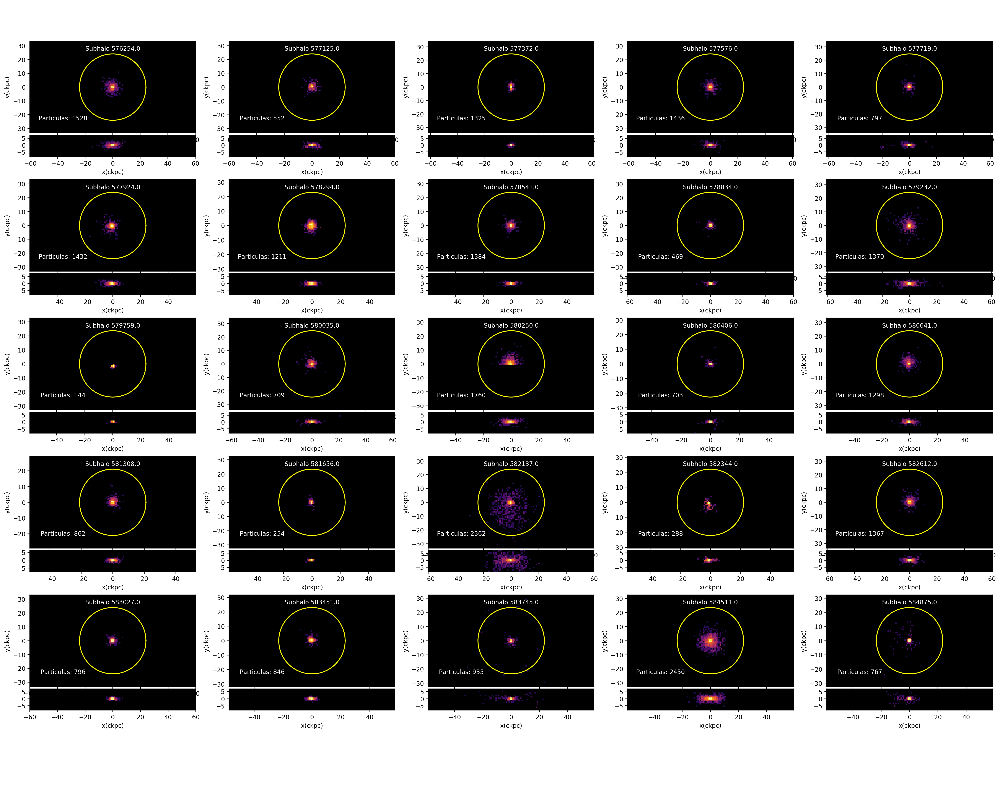

In [32]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

Classified_subhalos = np.genfromtxt('Classified_subhalos_TNG50-1.csv',skip_header=1,delimiter=',')
inicio = 100
step = 20
index = inicio
Subhalos_ids = Classified_subhalos[:,1]
Subhalos_R200 = Classified_subhalos[:,3]
circle = np.linspace(0, 2 * np.pi, 100)

fig = plt.figure(figsize=(28.66, 20.46), dpi=200)
outer = gridspec.GridSpec(5, 5, wspace=0.2, hspace=0.2)

for i in range(25):
    subhaloid = Subhalos_ids[index]
    R200 = Subhalos_R200[index]
    subhalo_df = pd.read_csv('subhalo_tables/subhalo%s_counterrotating.csv'%subhaloid)
    particle_count = len(subhalo_df['x'])
    
    
    
    inner = gridspec.GridSpecFromSubplotSpec(5, 1,
                    subplot_spec=outer[i], wspace=0.1, hspace=0.1)
    
    

    ax = plt.Subplot(fig, inner[0:4])
    histograma = ax.hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-0.5*R200, 0.5*R200], [-0.5*R200, 0.5*R200]])
    circulo_interior = ax.plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=15, label='0.2R200', color='yellow')
    t = ax.text(0,0.22*R200, 'Subhalo %s'%subhaloid, color='white', zorder=20)
    t.set_ha('center')
    t2 = ax.text(-0.3*R200,-0.2*R200, 'Particulas: %s'%particle_count, color='white', zorder=20)
    t2.set_ha('center')
    ax.axis('equal')
    ax.set_facecolor('black')
#     ax.set_xticks(range(int(-0.5*R200),int(0.5*R200),step))
#     ax.set_yticks(range(int(-0.5*R200),int(0.5*R200),step))
    ax.set_ylabel('y(ckpc)')
    fig.add_subplot(ax)
    
    ax2 = plt.Subplot(fig, inner[4], sharex=ax)
    histograma2 = ax2.hist2d(subhalo_df['x'],subhalo_df['z'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=10,range=[[-0.5*R200, 0.5*R200], [-0.5*R200, 0.5*R200]])
    ax2.axis('equal')
    ax2.set_facecolor('black')
    ax2.set(xlim=(-0.5*R200, 0.5*R200), ylim=(-0.1*R200-1, 0.1*R200))
#     ax2.set_xticks(range(int(-0.5*R200),int(0.5*R200),step))
#     ax2.set_yticks(range(int(-0.1*R200),int(0.1*R200),step))
    ax2.set_xlabel('x(ckpc)')
    fig.add_subplot(ax2)
    
    index += 1

fig.savefig('subhalo_images/Subhalos_counterrotating_%s.png'%inicio)

  0%|          | 0/11 [00:00<?, ?it/s]

subhalo_images/Subhalos_counterrotating_0.pdf
subhalo_images/Subhalos_counterrotating_25.pdf
subhalo_images/Subhalos_counterrotating_50.pdf
subhalo_images/Subhalos_counterrotating_75.pdf
subhalo_images/Subhalos_counterrotating_100.pdf
subhalo_images/Subhalos_counterrotating_125.pdf
subhalo_images/Subhalos_counterrotating_150.pdf
subhalo_images/Subhalos_counterrotating_175.pdf
subhalo_images/Subhalos_counterrotating_200.pdf
subhalo_images/Subhalos_counterrotating_225.pdf
subhalo_images/Subhalos_counterrotating_250.pdf


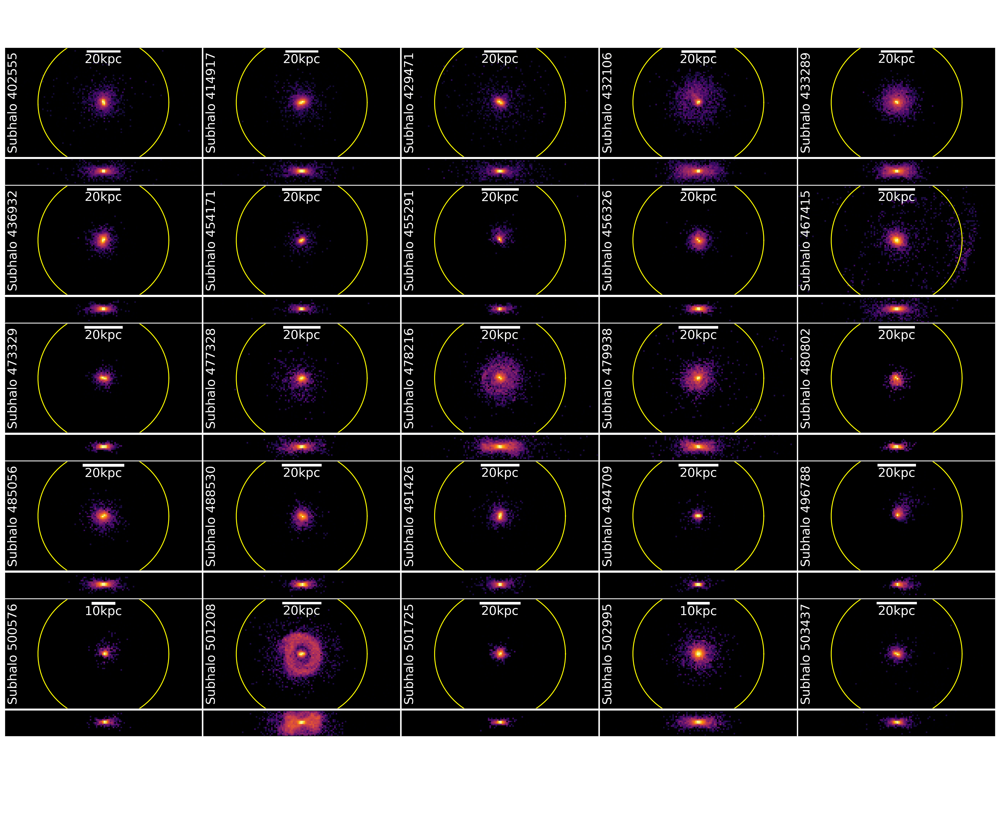

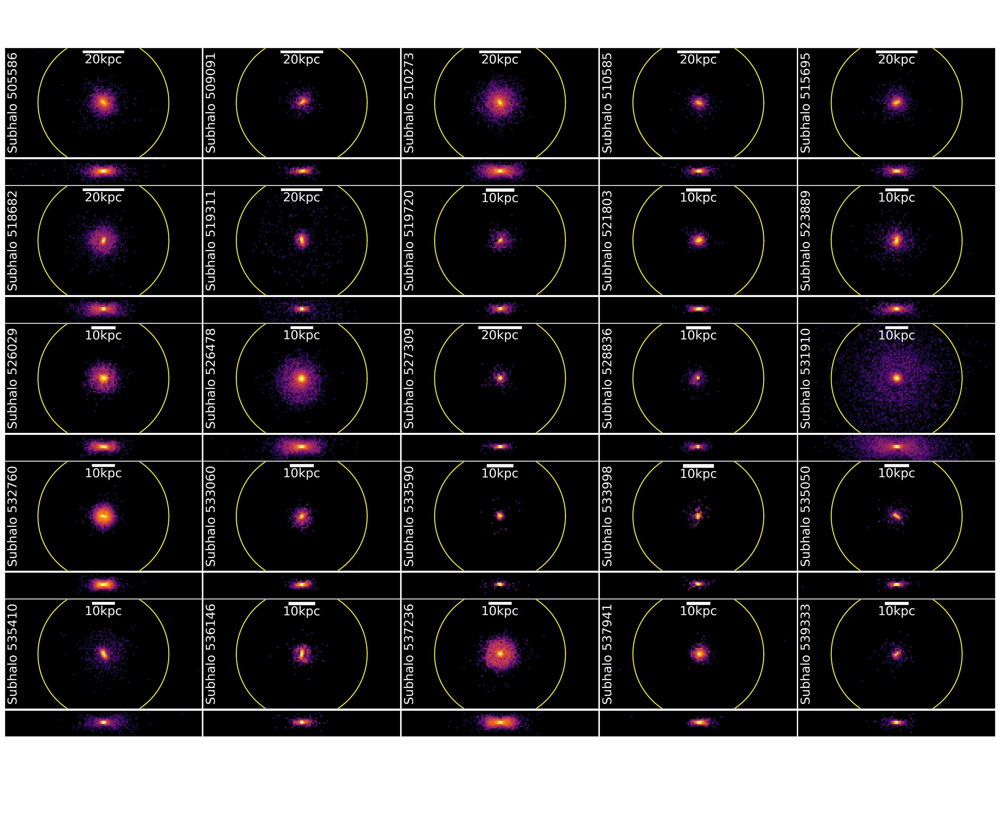

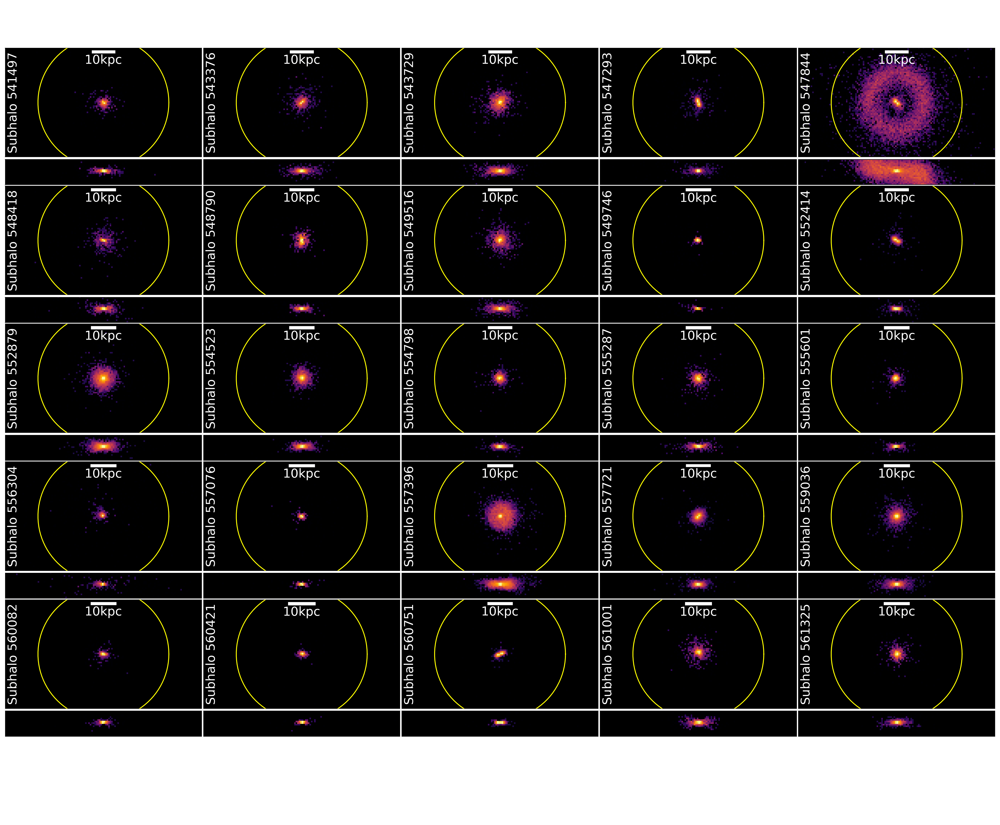

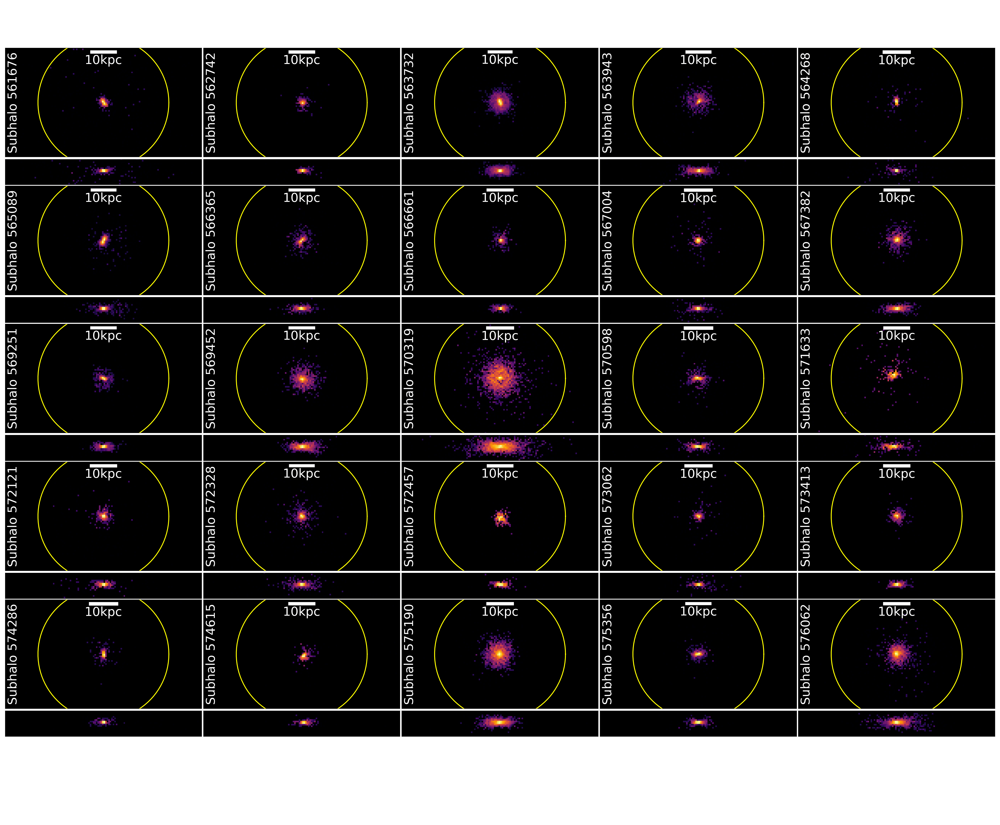

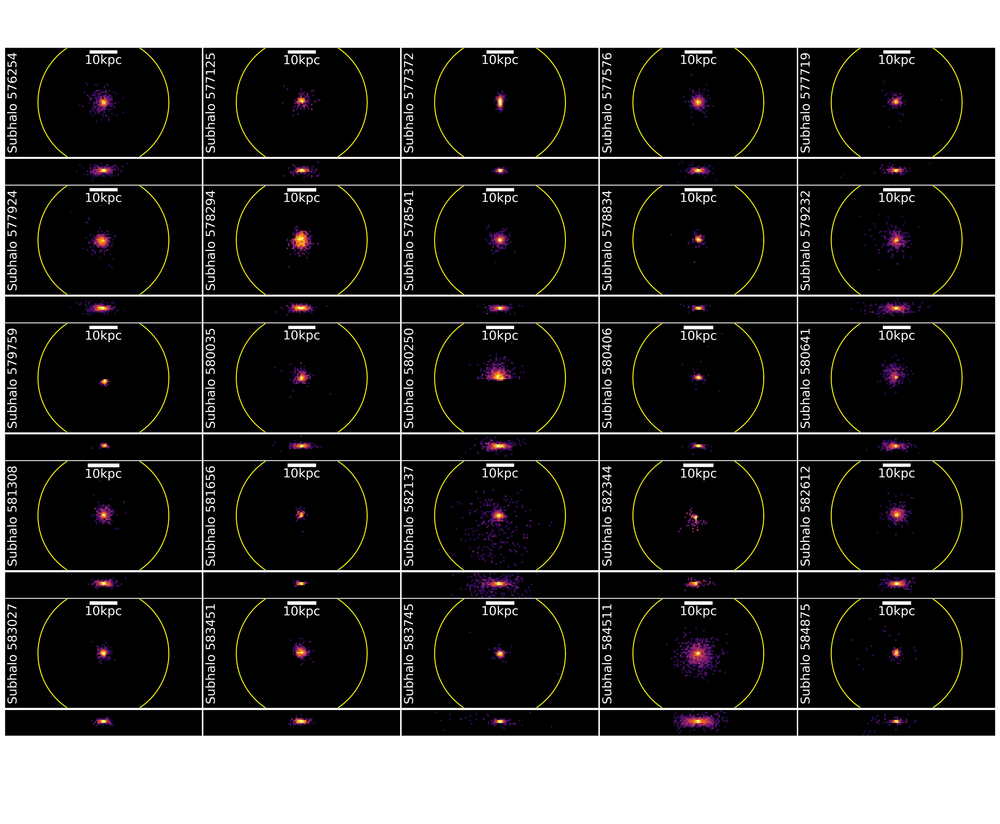

...

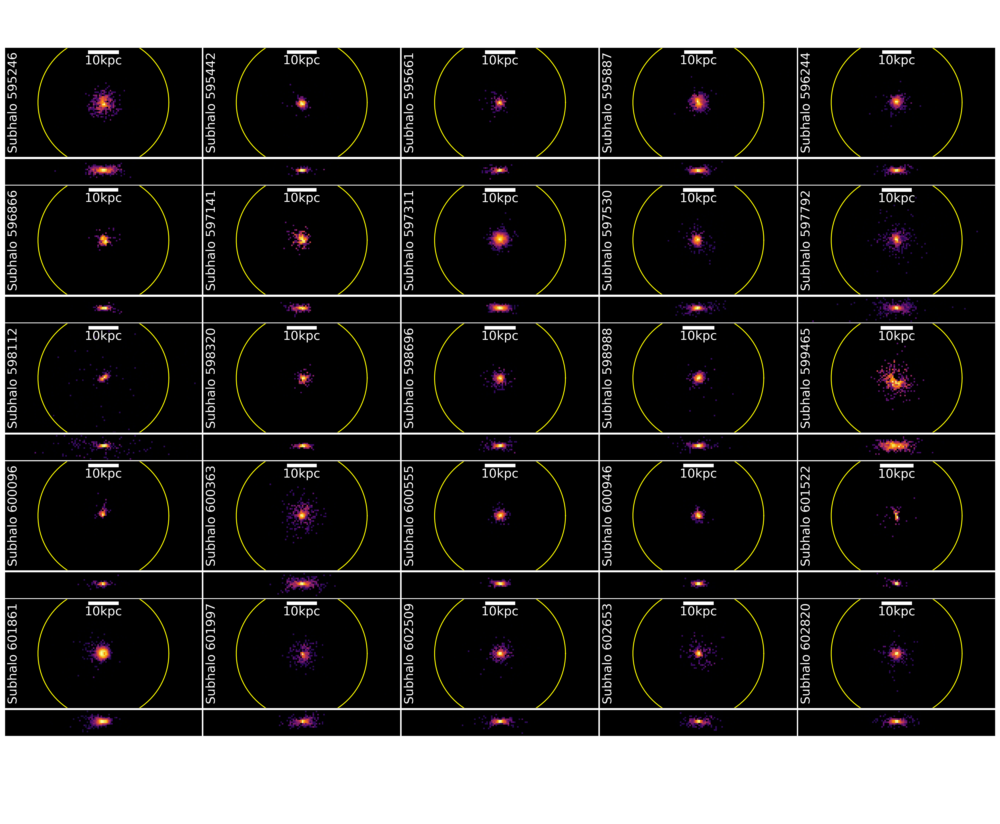

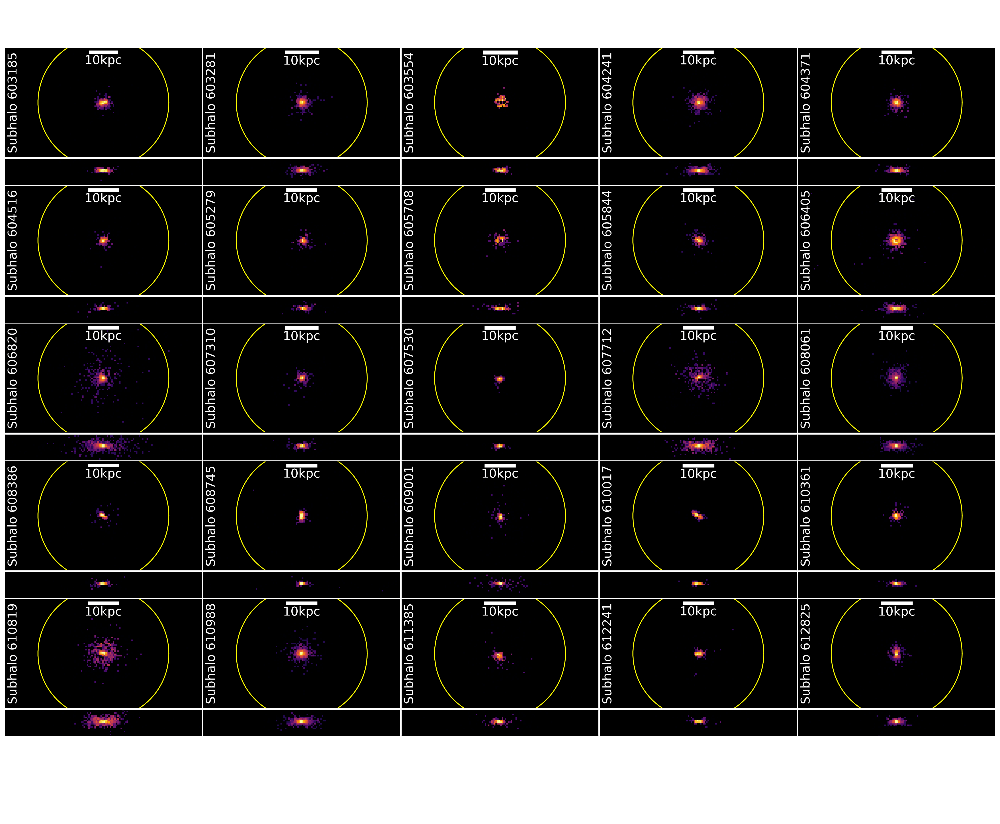

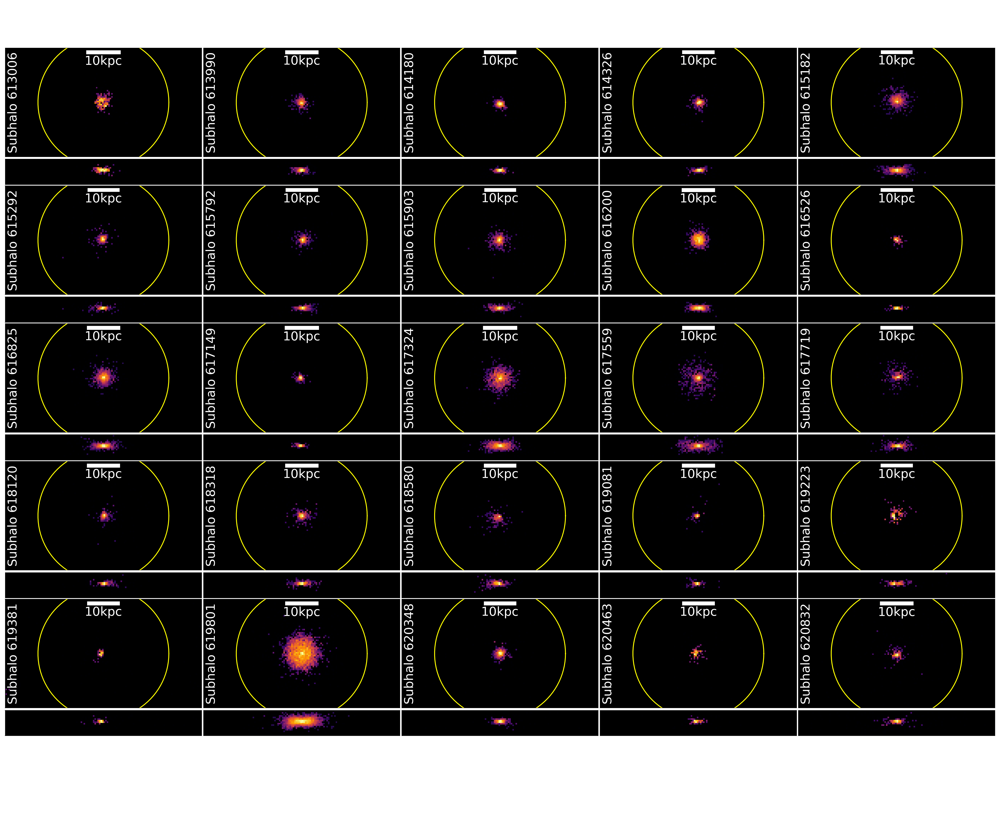

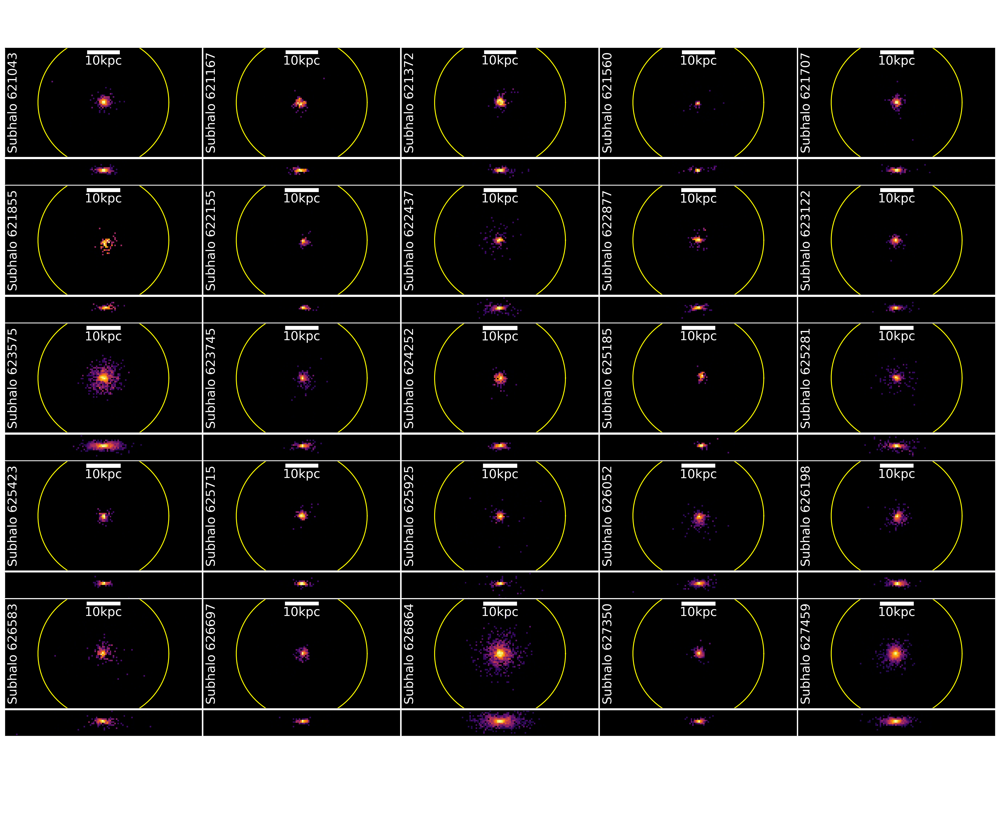

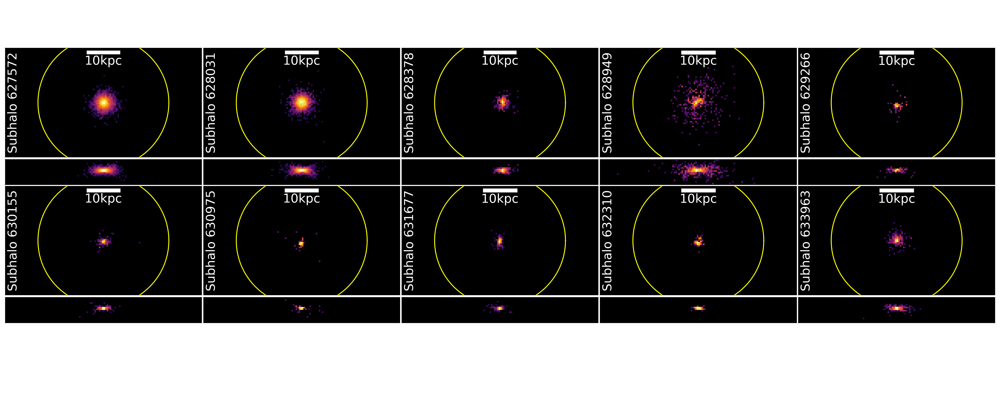

In [2]:
Classified_subhalos = np.genfromtxt('Classified_subhalos_TNG50-1.csv',skip_header=1,delimiter=',')

for start in tqdm(range(0,251,25)):
    inicio = start
    step = 20
    index = inicio
    
    Subhalos_ids = Classified_subhalos[:,1]
    Subhalos_R200 = Classified_subhalos[:,3]
    circle = np.linspace(0, 2 * np.pi, 100)

    fig = plt.figure(figsize=(28.66, 20.46), dpi=200)
    outer = gridspec.GridSpec(5, 5, wspace=0.01, hspace=0.01)

    for i in range(25):
        if index == 260:
            break
        subhaloid = Subhalos_ids[index]
        R200 = Subhalos_R200[index]
        subhalo_df = pd.read_csv('subhalo_tables/subhalo%s_counterrotating.csv'%subhaloid)
        particle_count = len(subhalo_df['x'])



        inner = gridspec.GridSpecFromSubplotSpec(5, 1,
                        subplot_spec=outer[i], wspace=0.1, hspace=0.1)



        ax = plt.Subplot(fig, inner[0:4])
        histograma = ax.hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=0,range=[[-0.3*R200, 0.3*R200], [-0.3*R200, 0.3*R200]])
        circulo_interior = ax.plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=15, label='Subhalo %s'%int(subhaloid), color='yellow')
        ax.axis('equal')
        ax.set_facecolor('black')
        xlocs = ax.get_xticks()
        ylocs = ax.get_yticks()
        textposx = (xlocs[1] + xlocs[0])/2
        textposy = ylocs[-3]
        escala_txt = str(int(xlocs[1] - xlocs[0]))
        escala_txt += 'kpc'
        fontprops = fm.FontProperties(size=20)
        scalebar = AnchoredSizeBar(ax.transData, int(xlocs[1] - xlocs[0]), escala_txt, 'upper center', pad=0.1, color='white', frameon=False, size_vertical=1, fontproperties=fontprops)
        ax.add_artist(scalebar)
        ax.text(.01,0.5,'Subhalo %s'%int(subhaloid), transform=ax.transAxes, color='white', ha='left', va='center', rotation='vertical', size=20)
        ax.tick_params(axis='x',which='both',bottom=False,top=False,labelbottom=False)
        ax.tick_params(axis='y',which='both',left=False,right=False,labelleft=False)
        fig.add_subplot(ax)

        ax2 = plt.Subplot(fig, inner[4], sharex=ax)
        histograma2 = ax2.hist2d(subhalo_df['x'],subhalo_df['z'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=0,range=[[-0.3*R200, 0.3*R200], [-0.3*R200, 0.3*R200]])
        ax2.axis('equal')
        ax2.set_facecolor('black')
        ax2.set(xlim=(-0.3*R200, 0.3*R200), ylim=(-0.1*R200-1, 0.1*R200))
        ax2.tick_params(axis='x',which='both',bottom=False,top=False,labelbottom=False)
        ax2.tick_params(axis='y',which='both',left=False,right=False,labelleft=False)
        fig.add_subplot(ax2)

        index += 1

    fig.savefig('subhalo_images/Subhalos_counterrotating_%s.pdf'%inicio,bbox_inches='tight')
    print('subhalo_images/Subhalos_counterrotating_%s.pdf'%inicio)

  0%|          | 0/11 [00:00<?, ?it/s]

subhalo_images/Subhalos_0.pdf
subhalo_images/Subhalos_25.pdf
subhalo_images/Subhalos_50.pdf
subhalo_images/Subhalos_75.pdf
subhalo_images/Subhalos_100.pdf
subhalo_images/Subhalos_125.pdf
subhalo_images/Subhalos_150.pdf
subhalo_images/Subhalos_175.pdf
subhalo_images/Subhalos_200.pdf
subhalo_images/Subhalos_225.pdf
subhalo_images/Subhalos_250.pdf


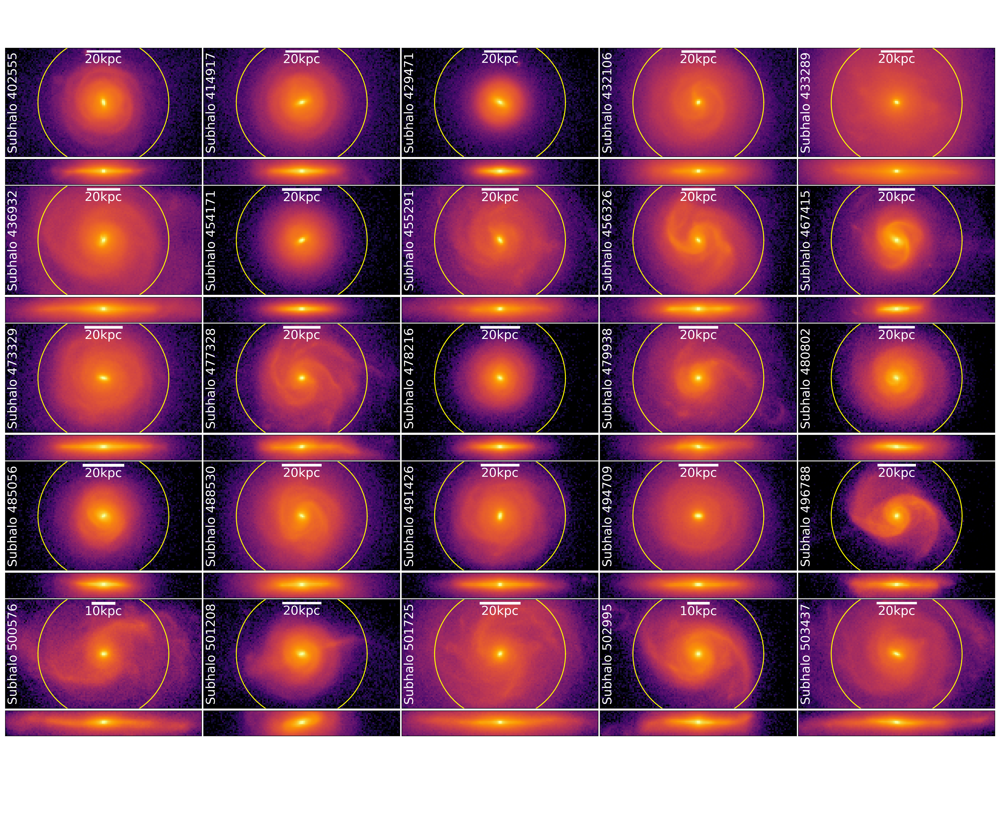

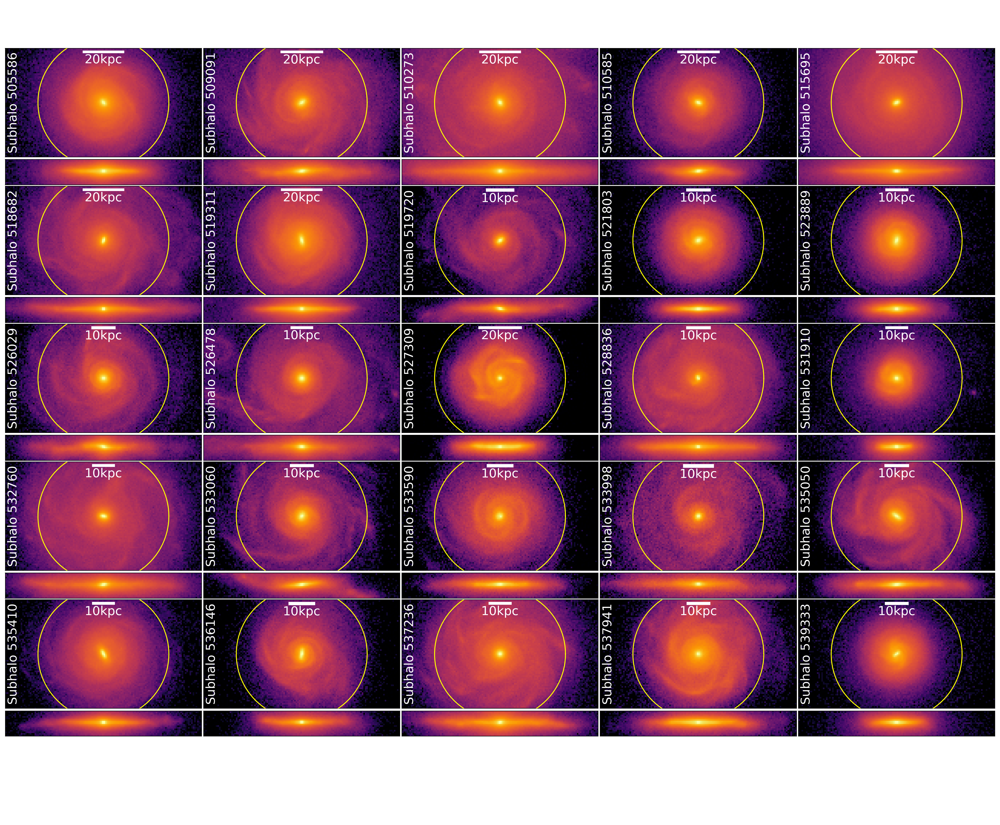

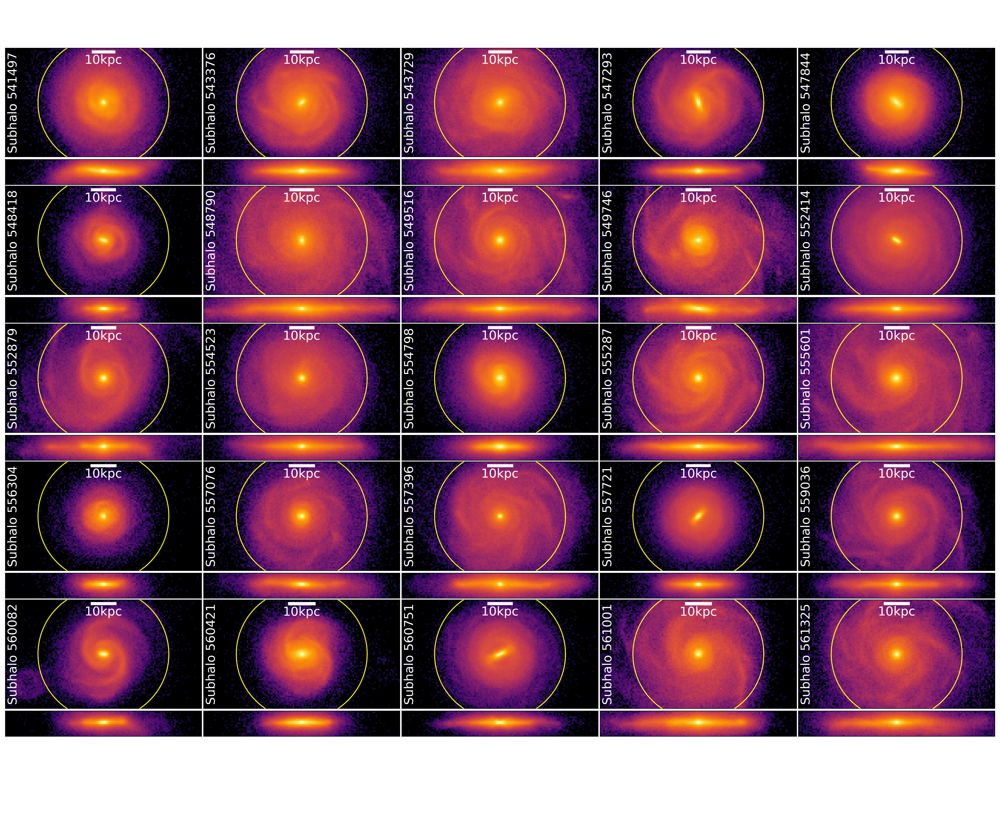

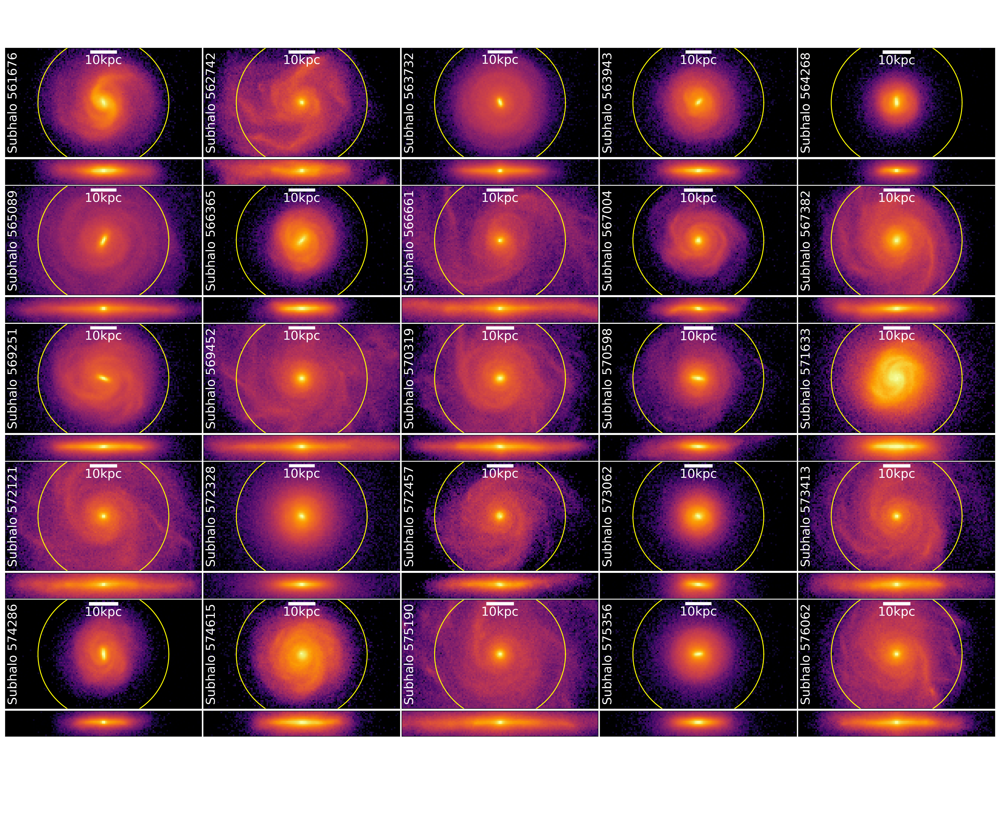

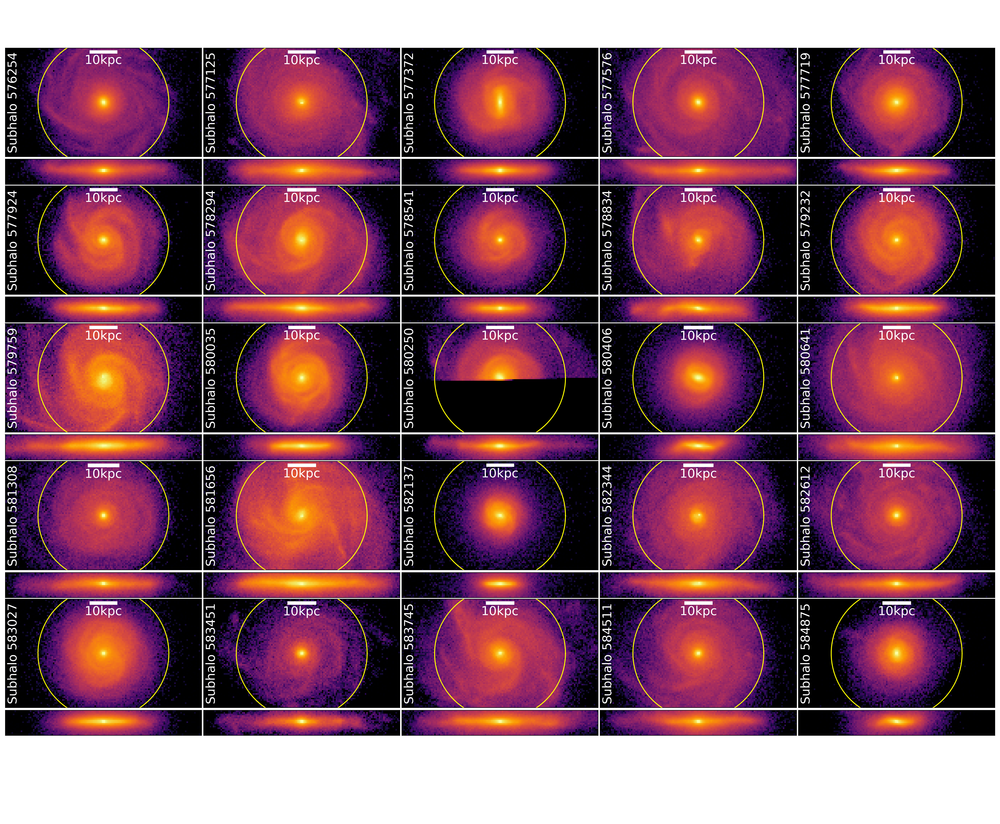

...

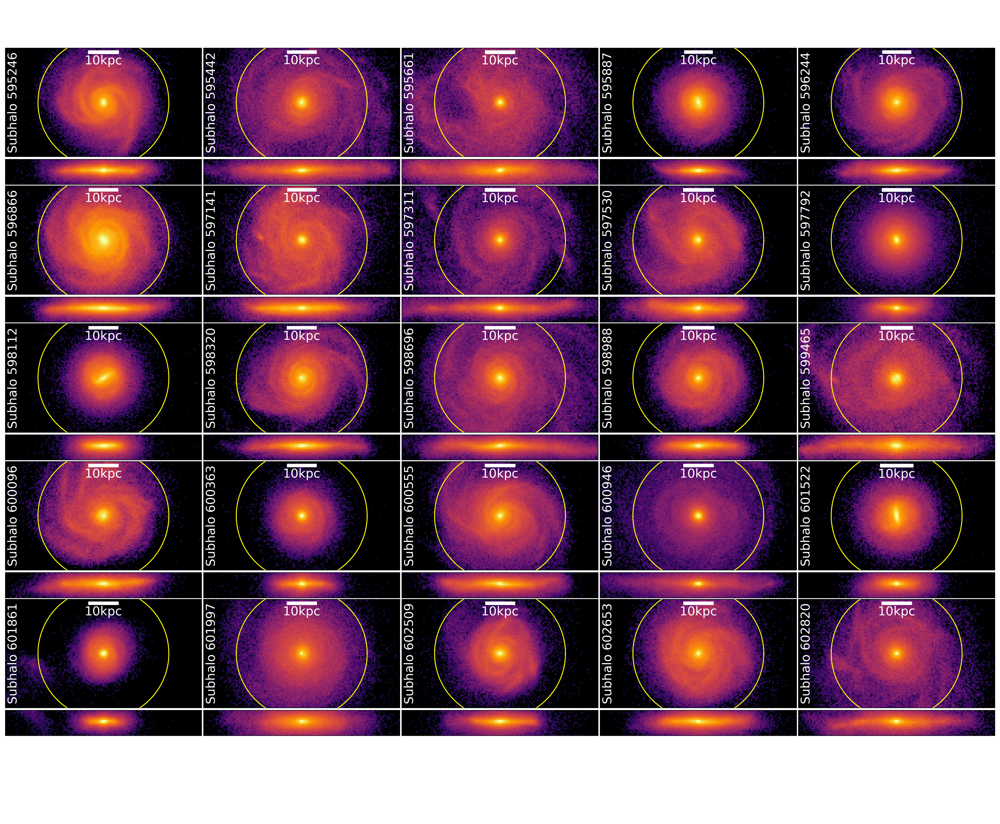

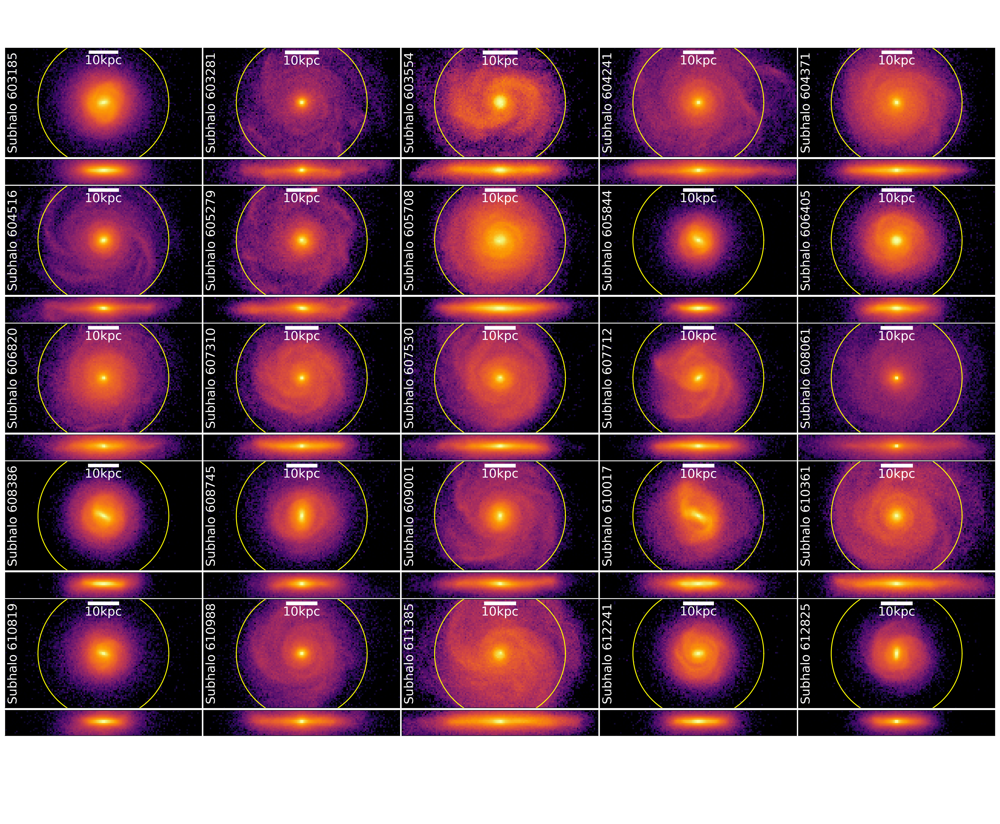

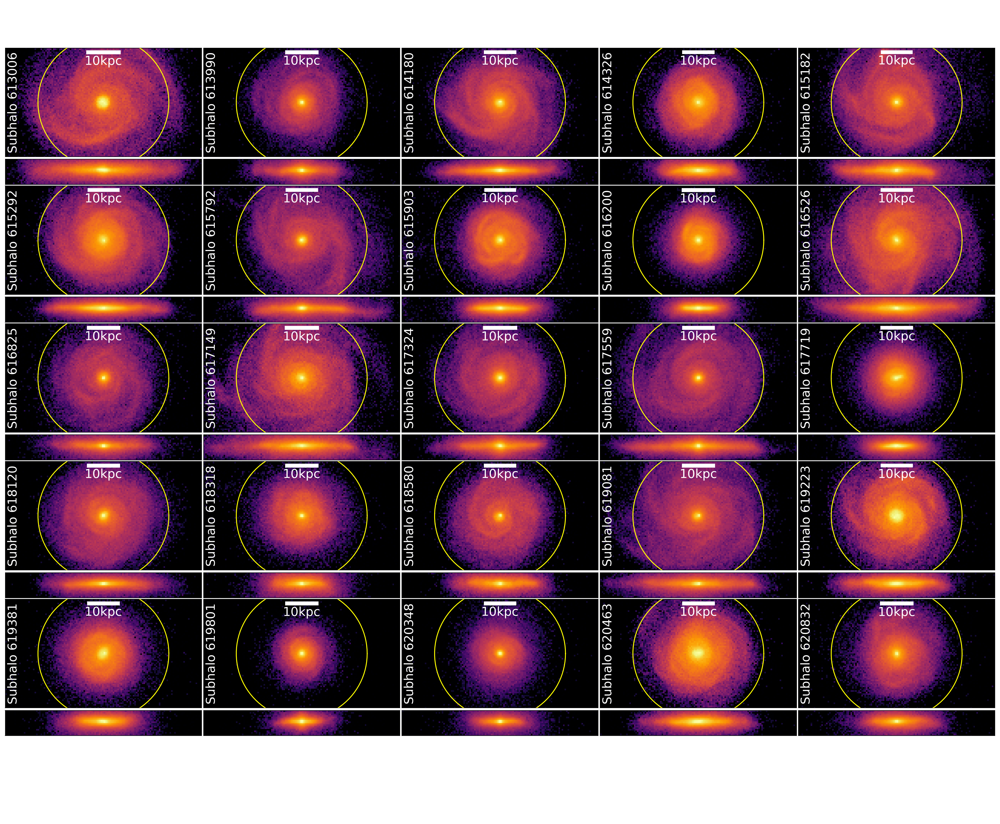

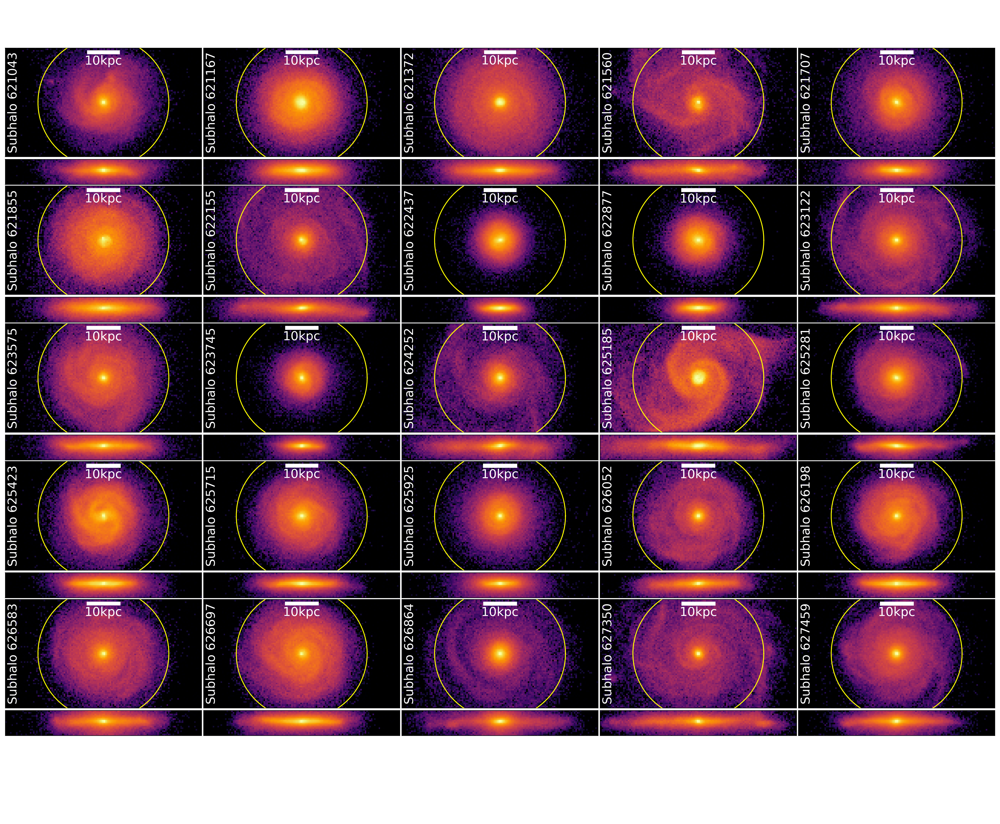

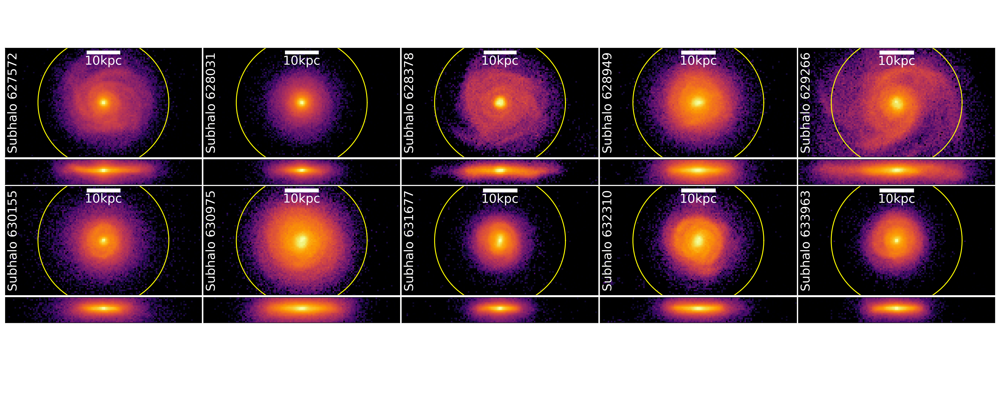

In [4]:
Classified_subhalos = np.genfromtxt('Classified_subhalos_TNG50-1.csv',skip_header=1,delimiter=',')

for start in tqdm(range(0,251,25)):
    inicio = start
    step = 20
    index = inicio
    
    Subhalos_ids = Classified_subhalos[:,1]
    Subhalos_R200 = Classified_subhalos[:,3]
    circle = np.linspace(0, 2 * np.pi, 100)

    fig = plt.figure(figsize=(28.66, 20.46), dpi=200)
    outer = gridspec.GridSpec(5, 5, wspace=0.01, hspace=0.01)

    for i in range(25):
        if index == 260:
            break
        subhaloid = Subhalos_ids[index]
        R200 = Subhalos_R200[index]
        subhalo_df = pd.read_csv('subhalo_tables/subhalo%s.csv'%subhaloid)
        particle_count = len(subhalo_df['x'])



        inner = gridspec.GridSpecFromSubplotSpec(5, 1,
                        subplot_spec=outer[i], wspace=0.1, hspace=0.1)



        ax = plt.Subplot(fig, inner[0:4])
        histograma = ax.hist2d(subhalo_df['x'],subhalo_df['y'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=0,range=[[-0.3*R200, 0.3*R200], [-0.3*R200, 0.3*R200]])
        circulo_interior = ax.plot((0.2*R200) * np.cos(circle), (0.2*R200) * np.sin(circle), zorder=15, label='Subhalo %s'%int(subhaloid), color='yellow')
        ax.axis('equal')
        ax.set_facecolor('black')
        xlocs = ax.get_xticks()
        ylocs = ax.get_yticks()
        textposx = (xlocs[1] + xlocs[0])/2
        textposy = ylocs[-3]
        escala_txt = str(int(xlocs[1] - xlocs[0]))
        escala_txt += 'kpc'
        fontprops = fm.FontProperties(size=20)
        scalebar = AnchoredSizeBar(ax.transData, int(xlocs[1] - xlocs[0]), escala_txt, 'upper center', pad=0.1, color='white', frameon=False, size_vertical=1, fontproperties=fontprops)
        ax.add_artist(scalebar)
        ax.text(.01,0.5,'Subhalo %s'%int(subhaloid), transform=ax.transAxes, color='white', ha='left', va='center', rotation='vertical', size=20)
        ax.tick_params(axis='x',which='both',bottom=False,top=False,labelbottom=False)
        ax.tick_params(axis='y',which='both',left=False,right=False,labelleft=False)
        fig.add_subplot(ax)

        ax2 = plt.Subplot(fig, inner[4], sharex=ax)
        histograma2 = ax2.hist2d(subhalo_df['x'],subhalo_df['z'],bins=128,cmap='inferno',norm=mpl.colors.LogNorm(), zorder=0,range=[[-0.3*R200, 0.3*R200], [-0.3*R200, 0.3*R200]])
        ax2.axis('equal')
        ax2.set_facecolor('black')
        ax2.set(xlim=(-0.3*R200, 0.3*R200), ylim=(-0.1*R200-1, 0.1*R200))
        ax2.tick_params(axis='x',which='both',bottom=False,top=False,labelbottom=False)
        ax2.tick_params(axis='y',which='both',left=False,right=False,labelleft=False)
        fig.add_subplot(ax2)

        index += 1
    
    fig.savefig('subhalo_images/Subhalos_%s.pdf'%inicio,bbox_inches='tight')
    print('subhalo_images/Subhalos_%s.pdf'%inicio)